In [1]:
import pandas as pd
import statistics as stats
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statistics as stats

In [2]:
business_dataset = pd.read_csv('CA1_business_dataset.csv')

In [3]:
business_dataset.head(10)

,Customer Satisfaction Score,Response Time,Daily User Logins,Average Session Duration,Survey Response Rate,Transaction Amount,Product Rating,Preferred Communication Channel,Membership Status,Product Category Preference,...,Referral Count,Account Age,Feedback Score,Product Return Rate,Marketing Email Click Rate,Subscription Status,Product Upsell Success,Customer Segment Group,Interest in New Product,Income Level
0,37,95.07,73,59.87,15.60,15.60,6,Email,Yes,Basic,...,18,30,52,Yes,29.12,1,1,C,No,High
1,79,19.97,51,59.24,4.65,60.75,17,Phone,Yes,Gold,...,12,50,3,No,25.88,1,1,C,No,Low
2,97,77.51,94,89.48,59.79,92.19,9,SMS,Yes,Platinum,...,54,14,80,Yes,98.69,1,1,C,No,Low
3,73,77.13,7,35.85,11.59,86.31,62,Email,Yes,Platinum,...,12,71,76,No,77.10,0,1,C,No,Low
4,3,63.64,31,50.86,90.76,24.93,41,Phone,Yes,Platinum,...,87,80,19,No,53.93,1,0,D,Yes,Medium
5,43,81.80,86,0.70,51.07,41.74,22,SMS,Yes,Gold,...,96,25,50,No,28.48,1,1,D,No,High
6,91,23.96,14,48.95,49.61,50.25,50,Email,Yes,Gold,...,84,32,19,No,59.09,0,1,B,Yes,Low
7,17,69.09,39,93.67,49.61,50.25,50,Phone,Yes,Platinum,...,9,90,90,No,33.90,1,0,C,Yes,Low
8,64,8.41,16,89.86,60.64,0.92,10,SMS,Yes,Basic,...,24,33,75,No,84.92,0,1,D,Yes,Medium
9,24,97.30,39,89.20,49.61,50.25,50,Email,Yes,Gold,...,94,95,91,No,1.55,1,0,B,Yes,Low


In [4]:
pd.set_option('display.max_columns', None)
business_dataset.head()

,Customer Satisfaction Score,Response Time,Daily User Logins,Average Session Duration,Survey Response Rate,Transaction Amount,Product Rating,Preferred Communication Channel,Membership Status,Product Category Preference,High-Value Purchase Count,Customer Support Calls,Website Click-Through Rate,Newsletter Open Rate,Social Media Engagement Score,Referral Count,Account Age,Feedback Score,Product Return Rate,Marketing Email Click Rate,Subscription Status,Product Upsell Success,Customer Segment Group,Interest in New Product,Income Level
0,37,95.07,73,59.87,15.60,15.60,6,Email,Yes,Basic,2.06,96.99,83,21.2,18.18,18,30,52,Yes,29.12,1,1,C,No,High
1,79,19.97,51,59.24,4.65,60.75,17,Phone,Yes,Gold,80.84,30.46,10,68.4,44.02,12,50,3,No,25.88,1,1,C,No,Low
2,97,77.51,94,89.48,59.79,92.19,9,SMS,Yes,Platinum,38.87,27.13,83,35.7,28.09,54,14,80,Yes,98.69,1,1,C,No,Low
3,73,77.13,7,35.85,11.59,86.31,62,Email,Yes,Platinum,32.52,72.96,64,88.7,47.22,12,71,76,No,77.10,0,1,C,No,Low
4,3,63.64,31,50.86,90.76,24.93,41,Phone,Yes,Platinum,28.98,16.12,93,80.8,63.34,87,80,19,No,53.93,1,0,D,Yes,Medium


### First of all, it needs rename to header because there are some space and special chacarcters between the words which could happen to be unable to return some functions:

In [5]:
business_dataset.rename(columns={"Customer Satisfaction Score": "Customer_Satisfaction_Score"}, inplace=True)
business_dataset.rename(columns={"Survey Response Rate": "Survey_Response_Rate"}, inplace=True)
business_dataset.rename(columns={"Transaction Amount": "Transaction_Amount"}, inplace=True)
business_dataset.rename(columns={"Product Rating": "Product_Rating"}, inplace=True)
business_dataset.rename(columns={"Product Category Preference": "Product_Category_Preference"}, inplace=True)
business_dataset.rename(columns={"High-Value Purchase Count": "High_Value_Purchase_Count"}, inplace=True)
business_dataset.rename(columns={"Website Click-Through Rate": "Website_Click_Through_Rate"}, inplace=True)
business_dataset.rename(columns={"Transaction Amount": "Transaction_Amount"}, inplace=True)
business_dataset.rename(columns={"Marketing Email Click Rate": "Marketing_Email_Click_Rate"}, inplace=True)
business_dataset.rename(columns={"Social Media Engagement Score": "Social_Media_Engagement_Score"}, inplace=True)
business_dataset.rename(columns={"Product Upsell Success": "Product_Upsell_Success"}, inplace=True)
business_dataset.rename(columns={"Social Media Engagement Score": "Social_Media_Engagement_Score"}, inplace=True)
business_dataset.rename(columns={"Website Click Through Rate": "Website_Click_Through_Rate"}, inplace=True)
business_dataset.rename(columns={"Product Return Rate": "Product_Return_Rate"}, inplace=True)
business_dataset.rename(columns={"Feedback Score": "Feedback_Score"}, inplace=True)
business_dataset.rename(columns={"Interest in New Product": "Interest_in_New_Product"}, inplace=True)
business_dataset.rename(columns={"Customer Segment Group": "Customer_Segment_Group"}, inplace=True)
business_dataset.rename(columns={"Income Level": "Income_Level"}, inplace=True)
business_dataset.rename(columns={"Subscription Status": "Subscription_Status"}, inplace=True)
business_dataset.rename(columns={"Customer Age": "Customer_Age"}, inplace=True)

In [6]:
business_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 25 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Customer_Satisfaction_Score      8000 non-null   int64  
 1   Response Time                    8000 non-null   float64
 2   Daily User Logins                8000 non-null   int64  
 3   Average Session Duration         8000 non-null   float64
 4   Survey_Response_Rate             8000 non-null   float64
 5   Transaction_Amount               8000 non-null   float64
 6   Product_Rating                   8000 non-null   int64  
 7   Preferred Communication Channel  8000 non-null   object 
 8   Membership Status                8000 non-null   object 
 9   Product_Category_Preference      8000 non-null   object 
 10  High_Value_Purchase_Count        8000 non-null   float64
 11  Customer Support Calls           8000 non-null   float64
 12  Website_Click_Throug

In [7]:
business_dataset.shape

(8000, 25)

In [8]:
business_dataset.isnull().sum()

Customer_Satisfaction_Score        0
Response Time                      0
Daily User Logins                  0
Average Session Duration           0
Survey_Response_Rate               0
Transaction_Amount                 0
Product_Rating                     0
Preferred Communication Channel    0
Membership Status                  0
Product_Category_Preference        0
High_Value_Purchase_Count          0
Customer Support Calls             0
Website_Click_Through_Rate         0
Newsletter Open Rate               0
Social_Media_Engagement_Score      0
Referral Count                     0
Account Age                        0
Feedback_Score                     0
Product_Return_Rate                0
Marketing_Email_Click_Rate         0
Subscription_Status                0
Product_Upsell_Success             0
Customer_Segment_Group             0
Interest_in_New_Product            0
Income_Level                       0
dtype: int64

In [9]:
business_dataset.describe()

,Customer_Satisfaction_Score,Response Time,Daily User Logins,Average Session Duration,Survey_Response_Rate,Transaction_Amount,Product_Rating,High_Value_Purchase_Count,Customer Support Calls,Website_Click_Through_Rate,Newsletter Open Rate,Social_Media_Engagement_Score,Referral Count,Account Age,Feedback_Score,Marketing_Email_Click_Rate,Subscription_Status,Product_Upsell_Success
count,8000.000000,8000.000000,8000.000000,8000.000000,8000.00000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000
mean,50.212000,49.856590,49.740750,50.498271,49.68128,50.281659,50.019625,57.124342,55.031480,56.785875,49.759737,50.521145,50.293250,49.403375,50.778125,49.413815,0.498250,0.497125
std,28.984204,28.890059,29.022191,28.828823,27.56277,27.280464,27.319000,85.944626,68.540857,81.386384,28.961474,28.759969,29.009579,28.566946,28.873026,28.729436,0.500028,0.500023
min,0.000000,0.000000,0.000000,0.010000,0.01000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000,0.000000
25%,25.000000,24.847500,24.750000,25.460000,26.59000,28.267500,28.000000,25.565000,24.817500,26.000000,24.400000,25.430000,25.000000,25.000000,26.000000,24.425000,0.000000,0.000000
50%,51.000000,49.705000,50.000000,51.000000,49.61000,50.250000,50.000000,50.765000,50.270000,51.000000,49.600000,50.705000,50.000000,49.000000,51.000000,49.345000,0.000000,0.000000
75%,76.000000,74.715000,75.000000,75.390000,72.35500,72.532500,72.000000,75.650000,76.012500,76.000000,74.900000,75.480000,76.000000,74.000000,76.000000,73.675000,1.000000,1.000000
max,100.000000,100.000000,100.000000,99.990000,100.00000,99.970000,100.000000,1476.420000,1179.480000,1297.000000,100.000000,100.000000,100.000000,100.000000,100.000000,99.970000,1.000000,1.000000


## Task 1 and 2:

Before starting properly replying the questions it was observed through the function isnull it has been checked for any missing values, which returned False, what indicates that has not missing values on these features selected on it.

## Purchase Frequency:
transactions amount(Numerical), Product Category Preference(categorical), High Value Purchase Count(Numerical), Customer_Segment_Group(object)

## Campaign Response Rate: 
Marketing Email Click Rate(Numerical), Social Media Engagement Score(continuous numerical), Product Upsell Success(binary numerical), Interest in New Product (Binary categorical)         

## Customer Feedback Score: 
Product Rating, Feedback Score(Numerical), Social Media Engagement Score, Website Click Through Rate(Numerical), Product Return Rate(numerical)

## Purchase Frequency:

transactions amount(Numerical), Product Category Preference(categorical), High Value Purchase Count(Numerical), Customer_Segment_Group(object)

In [10]:
bd_features=business_dataset[['Transaction_Amount', 'Product_Category_Preference', 'High_Value_Purchase_Count']]
bd_features.describe()

,Transaction_Amount,High_Value_Purchase_Count
count,8000.000000,8000.000000
mean,50.281659,57.124342
std,27.280464,85.944626
min,0.010000,0.000000
25%,28.267500,25.565000
50%,50.250000,50.765000
75%,72.532500,75.650000
max,99.970000,1476.420000


In [11]:
business_dataset['Transaction_Amount'].unique()

array([15.6 , 60.75, 92.19, ..., 97.67, 78.26, 65.48])

In [12]:
zero_exist = (business_dataset['Transaction_Amount'] == 0).any()
zero_exist

False

In [13]:
business_dataset_mean_transaction = business_dataset['Transaction_Amount'].mean()

In [14]:
business_dataset['Transaction_Amount'] = business_dataset['Transaction_Amount'].replace(0, business_dataset_mean_transaction)

In [15]:
value_counts = business_dataset['Transaction_Amount'].value_counts()
value_counts

Transaction_Amount
50.25    801
17.72      7
36.26      6
9.90       6
93.15      6
        ... 
51.78      1
25.19      1
36.16      1
59.01      1
65.48      1
Name: count, Length: 5156, dtype: int64

In [16]:
relative_frequencies = value_counts/len(business_dataset)    #length
relative_frequencies

Transaction_Amount
50.25    0.100125
17.72    0.000875
36.26    0.000750
9.90     0.000750
93.15    0.000750
           ...   
51.78    0.000125
25.19    0.000125
36.16    0.000125
59.01    0.000125
65.48    0.000125
Name: count, Length: 5156, dtype: float64

### Product_Category_Preference

In [17]:
value_counts1 = business_dataset['Product_Category_Preference'].value_counts()
value_counts1

Product_Category_Preference
Gold        3162
Platinum    2783
Basic       2055
Name: count, dtype: int64

In [18]:
relative_frequencies1 = value_counts1/len(business_dataset)   
relative_frequencies1

Product_Category_Preference
Gold        0.395250
Platinum    0.347875
Basic       0.256875
Name: count, dtype: float64

In [19]:
subtable1 = pd.DataFrame({'Product_Category_Preference': value_counts1.index,
                        'Frequency': value_counts1.values,
                        'Relative Frequency': relative_frequencies1.values})

In [20]:
subtable1

,Product_Category_Preference,Frequency,Relative Frequency
0,Gold,3162,0.395250
1,Platinum,2783,0.347875
2,Basic,2055,0.256875


C:\Users\Admin\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


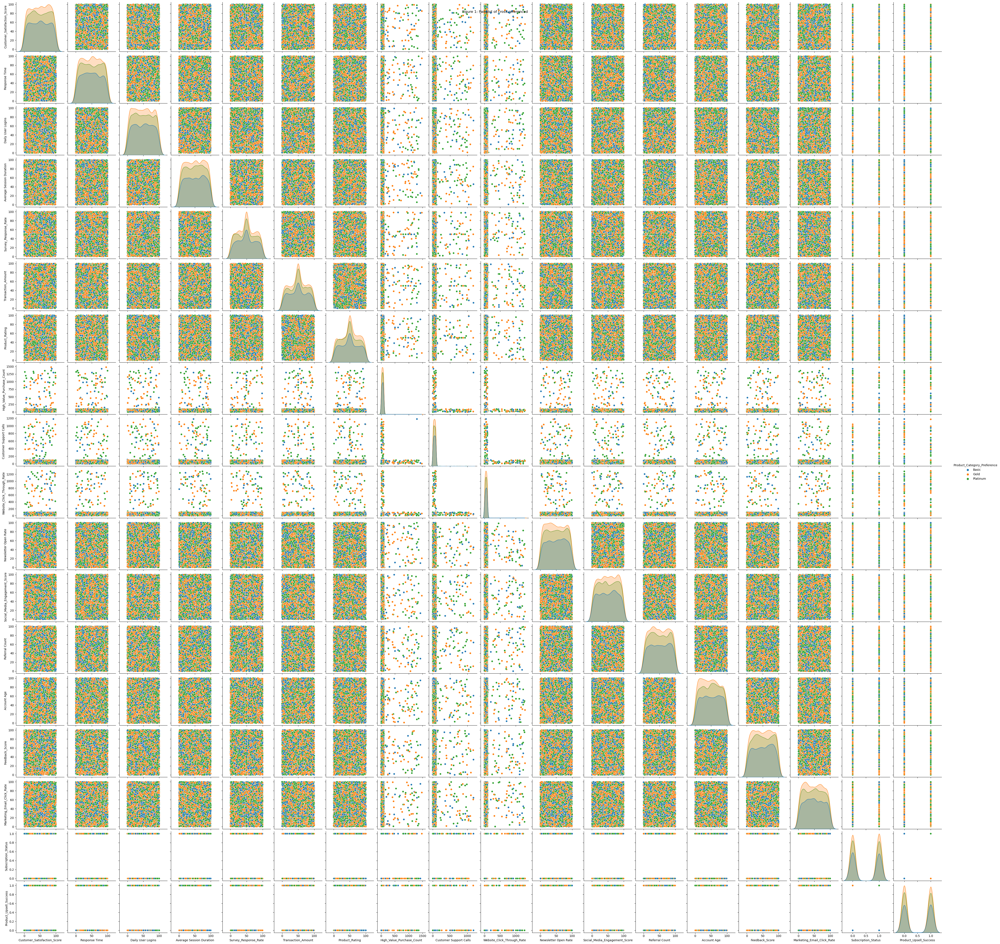

In [21]:
sns.pairplot(business_dataset, hue='Product_Category_Preference')
plt.suptitle('Figure 1: Pairplot of cross-referenced')
plt.show()

### Customer_Segment_Group

In [22]:
value_counts_product_category = business_dataset['Customer_Segment_Group'].value_counts()
value_counts_product_category

Customer_Segment_Group
B    2028
A    1998
D    1996
C    1978
Name: count, dtype: int64

In [23]:
relative_frequencies_product_category = value_counts_product_category/len(business_dataset) 
relative_frequencies_product_category

Customer_Segment_Group
B    0.25350
A    0.24975
D    0.24950
C    0.24725
Name: count, dtype: float64

In [24]:
subtable_product = pd.DataFrame({'Customer_Segment_Group': value_counts_product_category.index,
                        'Frequency': value_counts_product_category.values,
                        'Relative Frequency': relative_frequencies_product_category.values})

In [25]:
subtable_product

,Customer_Segment_Group,Frequency,Relative Frequency
0,B,2028,0.25350
1,A,1998,0.24975
2,D,1996,0.24950
3,C,1978,0.24725


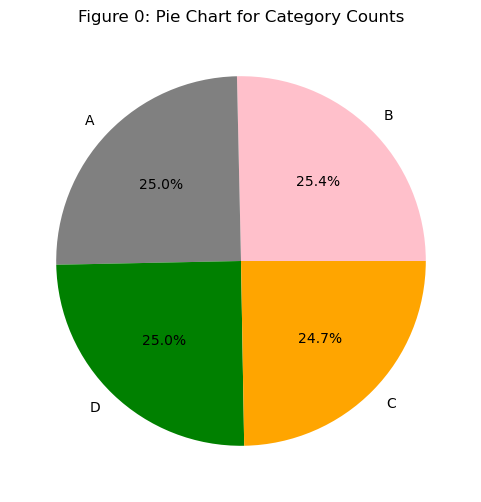

In [168]:
category_counts = business_dataset['Customer_Segment_Group'].value_counts()
colors = ['pink', 'grey', 'green', 'orange'] 

plt.figure(figsize=(6, 6))
plt.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%', colors=colors)

plt.title('Figure 0: Pie Chart for Category Counts')

plt.show()

## Income Level

In [26]:
value_counts_segment = business_dataset['Income_Level'].value_counts()
value_counts_segment

Income_Level
Low       2720
Medium    2666
High      2614
Name: count, dtype: int64

In [27]:
relative_frequencies_segment = value_counts_segment/len(business_dataset)    #length
relative_frequencies_segment

Income_Level
Low       0.34000
Medium    0.33325
High      0.32675
Name: count, dtype: float64

In [28]:
subtable_Segment = pd.DataFrame({'Income_Level': value_counts_segment.index,
                        'Frequency': value_counts_segment.values,
                        'Relative Frequency': relative_frequencies_segment.values})

In [29]:
subtable_Segment

,Income_Level,Frequency,Relative Frequency
0,Low,2720,0.34000
1,Medium,2666,0.33325
2,High,2614,0.32675


In [30]:
from sklearn.preprocessing import LabelEncoder
from numpy import asarray
data = asarray([['Low'], ['Medium'], ['High']])
data

array([['Low'],
       ['Medium'],
       ['High']], dtype='<U6')

In [31]:
encoder = LabelEncoder()

In [32]:
result=encoder.fit_transform(data)
result

C:\Users\Admin\anaconda3\Lib\site-packages\sklearn\preprocessing\_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


array([1, 2, 0], dtype=int64)

In [33]:
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder(sparse=False)
result = encoder.fit_transform(data)
result

C:\Users\Admin\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


array([[0., 1., 0.],
       [0., 0., 1.],
       [1., 0., 0.]])

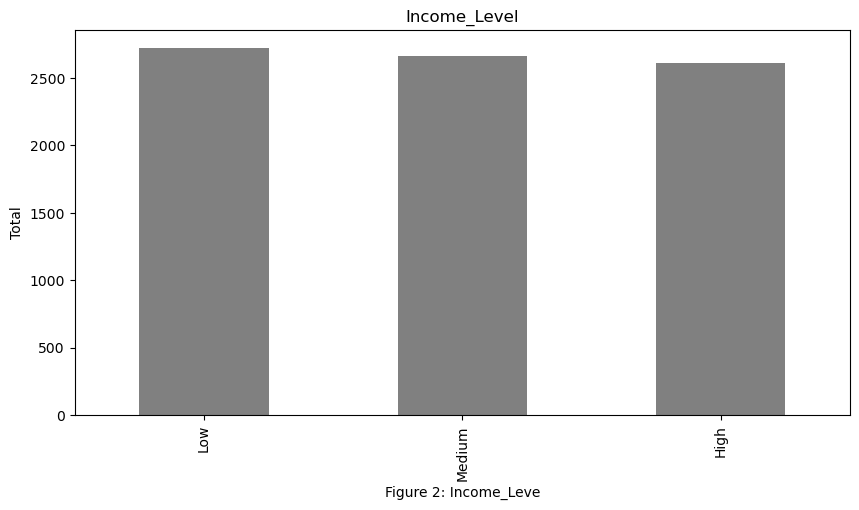

In [34]:
business_dataset.Income_Level.value_counts().nlargest(10).plot(kind="bar", figsize=(10,5), color='grey')
plt.title("Income_Level")
plt.ylabel("Total")
plt.xlabel("Figure 2: Income_Leve");

[Text(0.5, 0, 'Income_Level'),
 Text(0, 0.5, 'Counts'),
 Text(0.5, 1.0, 'Figure 3: Income Level Histogram')]

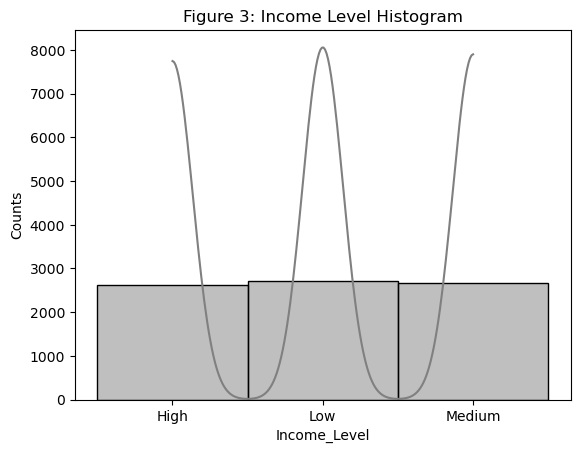

In [35]:
ax = sns.histplot(business_dataset.Income_Level, kde = True, color='grey')
ax.set(xlabel = 'Income_Level', ylabel = 'Counts', title = 'Figure 3: Income Level Histogram')

### High Value Purchase Count

In [36]:
bd_features=business_dataset[['Transaction_Amount', 'Product_Category_Preference', 'High_Value_Purchase_Count']]
bd_features.describe()

,Transaction_Amount,High_Value_Purchase_Count
count,8000.000000,8000.000000
mean,50.281659,57.124342
std,27.280464,85.944626
min,0.010000,0.000000
25%,28.267500,25.565000
50%,50.250000,50.765000
75%,72.532500,75.650000
max,99.970000,1476.420000


In [37]:
value_counts2 = business_dataset['High_Value_Purchase_Count'].value_counts()
value_counts2

High_Value_Purchase_Count
28.48    6
99.43    5
83.97    5
60.78    5
9.71     5
        ..
30.36    1
77.93    1
6.65     1
88.24    1
19.22    1
Name: count, Length: 5561, dtype: int64

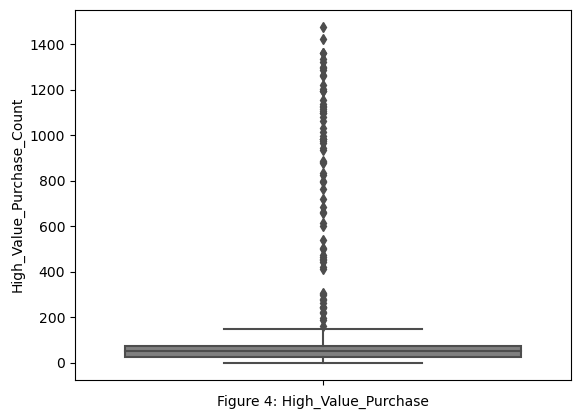

In [38]:
color = 'grey'
High_Value_Purchase_Count_outlier = business_dataset['High_Value_Purchase_Count']

sns.boxplot(y=High_Value_Purchase_Count_outlier, color=color)
plt.xlabel('Figure 4: High_Value_Purchase')

plt.show()

#### As the Marketing_Email_Click_Rate	is Continuous numerical data indicating the click rate on marketing emails, in percentage. and some of them are 120, I am assuming there are sparse data. then will be used minmax scaler.

### It was tested three differrent scaler models to be able which one was the best one:
#'minmaxScaler', 'standardized', 'l2_normalize'

In [39]:
import pandas as pd
import seaborn as sns
import sklearn.preprocessing as preproc
from sklearn.preprocessing import MinMaxScaler

C:\Users\Admin\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


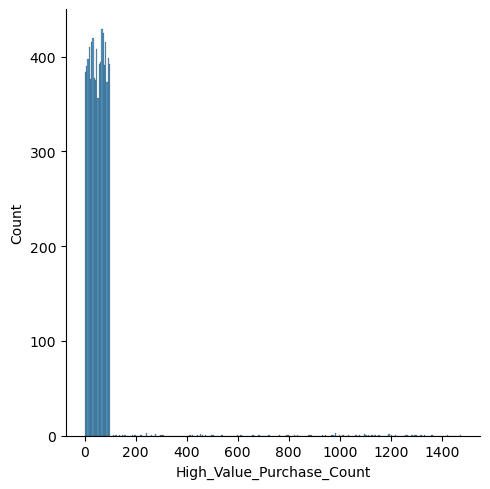

In [40]:
sns.displot(data=business_dataset, x ="High_Value_Purchase_Count")

In [41]:
df = pd.read_csv("CA1_business_dataset.csv", delimiter = ". ")

C:\Users\Admin\AppData\Local\Temp\ipykernel_31112\27759913.py:1: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  df = pd.read_csv("CA1_business_dataset.csv", delimiter = ". ")


In [42]:
business_dataset["minmax"]=preproc.minmax_scale(business_dataset["High_Value_Purchase_Count"])

C:\Users\Admin\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


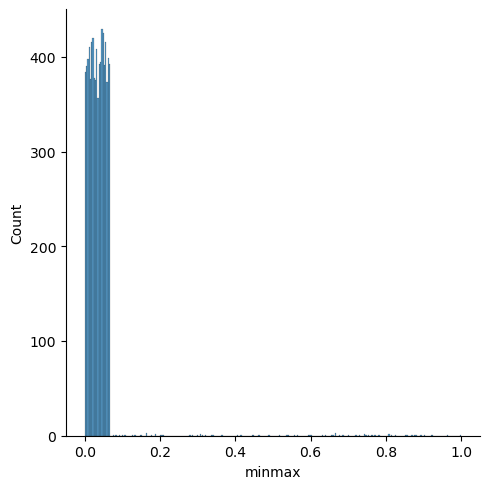

In [43]:
sns.displot(data=business_dataset, x = "minmax")

In [44]:
business_dataset["standardized"]=preproc.StandardScaler().fit_transform(business_dataset[["High_Value_Purchase_Count"]])

In [45]:
business_dataset["standardized"]

0      -0.640736
1       0.275958
2      -0.212410
3      -0.286299
4      -0.327491
          ...   
7995    0.265602
7996   -0.441060
7997    0.152034
7998   -0.659237
7999   -0.577901
Name: standardized, Length: 8000, dtype: float64

In [46]:
business_dataset

,Customer_Satisfaction_Score,Response Time,Daily User Logins,Average Session Duration,Survey_Response_Rate,Transaction_Amount,Product_Rating,Preferred Communication Channel,Membership Status,Product_Category_Preference,High_Value_Purchase_Count,Customer Support Calls,Website_Click_Through_Rate,Newsletter Open Rate,Social_Media_Engagement_Score,Referral Count,Account Age,Feedback_Score,Product_Return_Rate,Marketing_Email_Click_Rate,Subscription_Status,Product_Upsell_Success,Customer_Segment_Group,Interest_in_New_Product,Income_Level,minmax,standardized
0,37,95.07,73,59.87,15.60,15.60,6,Email,Yes,Basic,2.06,96.99,83,21.2,18.18,18,30,52,Yes,29.12,1,1,C,No,High,0.001395,-0.640736
1,79,19.97,51,59.24,4.65,60.75,17,Phone,Yes,Gold,80.84,30.46,10,68.4,44.02,12,50,3,No,25.88,1,1,C,No,Low,0.054754,0.275958
2,97,77.51,94,89.48,59.79,92.19,9,SMS,Yes,Platinum,38.87,27.13,83,35.7,28.09,54,14,80,Yes,98.69,1,1,C,No,Low,0.026327,-0.212410
3,73,77.13,7,35.85,11.59,86.31,62,Email,Yes,Platinum,32.52,72.96,64,88.7,47.22,12,71,76,No,77.10,0,1,C,No,Low,0.022026,-0.286299
4,3,63.64,31,50.86,90.76,24.93,41,Phone,Yes,Platinum,28.98,16.12,93,80.8,63.34,87,80,19,No,53.93,1,0,D,Yes,Medium,0.019629,-0.327491
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7995,31,4.00,2,21.03,72.98,57.18,12,Email,Yes,Gold,79.95,49.90,19,45.6,47.11,66,37,69,No,67.56,0,0,A,Yes,Low,0.054151,0.265602
7996,54,1.15,84,13.64,74.77,97.67,28,Phone,Yes,Basic,19.22,90.83,59,79.2,12.81,44,18,35,No,27.26,0,0,B,No,Low,0.013018,-0.441060
7997,90,41.24,21,68.26,85.86,78.26,56,SMS,Yes,Gold,70.19,94.71,77,53.8,61.17,20,18,17,No,4.18,0,1,C,No,Low,0.047541,0.152034
7998,20,49.44,89,58.79,1.92,65.48,60,Email,Yes,Platinum,0.47,4.78,1,82.0,91.58,2,52,17,No,51.50,0,0,D,Yes,Low,0.000318,-0.659237


In [47]:
business_dataset["l2_normalize"]=preproc.normalize(business_dataset[["High_Value_Purchase_Count"]], axis=0)

In [48]:
business_dataset["l2_normalize"]

0       0.000223
1       0.008759
2       0.004211
3       0.003523
4       0.003140
          ...   
7995    0.008662
7996    0.002082
7997    0.007605
7998    0.000051
7999    0.000808
Name: l2_normalize, Length: 8000, dtype: float64

In [49]:
business_dataset.head()

,Customer_Satisfaction_Score,Response Time,Daily User Logins,Average Session Duration,Survey_Response_Rate,Transaction_Amount,Product_Rating,Preferred Communication Channel,Membership Status,Product_Category_Preference,High_Value_Purchase_Count,Customer Support Calls,Website_Click_Through_Rate,Newsletter Open Rate,Social_Media_Engagement_Score,Referral Count,Account Age,Feedback_Score,Product_Return_Rate,Marketing_Email_Click_Rate,Subscription_Status,Product_Upsell_Success,Customer_Segment_Group,Interest_in_New_Product,Income_Level,minmax,standardized,l2_normalize
0,37,95.07,73,59.87,15.60,15.60,6,Email,Yes,Basic,2.06,96.99,83,21.2,18.18,18,30,52,Yes,29.12,1,1,C,No,High,0.001395,-0.640736,0.000223
1,79,19.97,51,59.24,4.65,60.75,17,Phone,Yes,Gold,80.84,30.46,10,68.4,44.02,12,50,3,No,25.88,1,1,C,No,Low,0.054754,0.275958,0.008759
2,97,77.51,94,89.48,59.79,92.19,9,SMS,Yes,Platinum,38.87,27.13,83,35.7,28.09,54,14,80,Yes,98.69,1,1,C,No,Low,0.026327,-0.212410,0.004211
3,73,77.13,7,35.85,11.59,86.31,62,Email,Yes,Platinum,32.52,72.96,64,88.7,47.22,12,71,76,No,77.10,0,1,C,No,Low,0.022026,-0.286299,0.003523
4,3,63.64,31,50.86,90.76,24.93,41,Phone,Yes,Platinum,28.98,16.12,93,80.8,63.34,87,80,19,No,53.93,1,0,D,Yes,Medium,0.019629,-0.327491,0.003140


In [50]:
bd_features=business_dataset[['minmax', 'standardized', 'l2_normalize']]
bd_features.describe()

,minmax,standardized,l2_normalize
count,8000.000000,8.000000e+03,8000.000000
mean,0.038691,3.108624e-17,0.006189
std,0.058212,1.000063e+00,0.009312
min,0.000000,-6.647061e-01,0.000000
25%,0.017316,-3.672285e-01,0.002770
50%,0.034384,-7.399811e-02,0.005500
75%,0.051239,2.155669e-01,0.008196
max,1.000000,1.651510e+01,0.159962


In [51]:
top_10_modes = business_dataset['High_Value_Purchase_Count'].value_counts().head(10)

print(top_10_modes)

High_Value_Purchase_Count
28.48    6
99.43    5
83.97    5
60.78    5
9.71     5
55.77    5
71.79    5
86.20    5
16.86    4
92.69    4
Name: count, dtype: int64


In [52]:
relative_frequencies2 = value_counts2/len(business_dataset)   
relative_frequencies2

High_Value_Purchase_Count
28.48    0.000750
99.43    0.000625
83.97    0.000625
60.78    0.000625
9.71     0.000625
           ...   
30.36    0.000125
77.93    0.000125
6.65     0.000125
88.24    0.000125
19.22    0.000125
Name: count, Length: 5561, dtype: float64

In [53]:
subtable2 = pd.DataFrame({'High_Value_Purchase_Count': value_counts2.index,
                        'Frequency': value_counts2.values,
                        'Relative Frequency': relative_frequencies2.values})

In [54]:
subtable2

,High_Value_Purchase_Count,Frequency,Relative Frequency
0,28.48,6,0.000750
1,99.43,5,0.000625
2,83.97,5,0.000625
3,60.78,5,0.000625
4,9.71,5,0.000625
...,...,...,...
5556,30.36,1,0.000125
5557,77.93,1,0.000125
5558,6.65,1,0.000125
5559,88.24,1,0.000125


In [55]:
value_counts_minmax = business_dataset['minmax'].value_counts()
value_counts_minmax

minmax
0.019290    6
0.067345    5
0.056874    5
0.041167    5
0.006577    5
           ..
0.020563    1
0.052783    1
0.004504    1
0.059766    1
0.013018    1
Name: count, Length: 5561, dtype: int64

In [56]:
relative_frequencies_minmax = value_counts_minmax/len(business_dataset)  
relative_frequencies_minmax

minmax
0.019290    0.000750
0.067345    0.000625
0.056874    0.000625
0.041167    0.000625
0.006577    0.000625
              ...   
0.020563    0.000125
0.052783    0.000125
0.004504    0.000125
0.059766    0.000125
0.013018    0.000125
Name: count, Length: 5561, dtype: float64

In [57]:
subtable_minmax = pd.DataFrame({'High_Value_Purchase_Count': value_counts_minmax.index,
                        'Frequency': value_counts_minmax.values,
                        'Relative Frequency': relative_frequencies_minmax.values})

In [58]:
subtable_minmax

,High_Value_Purchase_Count,Frequency,Relative Frequency
0,0.019290,6,0.000750
1,0.067345,5,0.000625
2,0.056874,5,0.000625
3,0.041167,5,0.000625
4,0.006577,5,0.000625
...,...,...,...
5556,0.020563,1,0.000125
5557,0.052783,1,0.000125
5558,0.004504,1,0.000125
5559,0.059766,1,0.000125


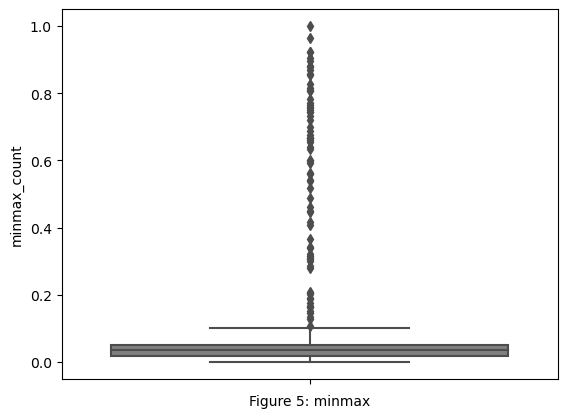

In [59]:
color = 'grey'
min_max_no_outliers = business_dataset['minmax']
sns.boxplot(y=min_max_no_outliers, color=color)
plt.ylabel('minmax_count')
plt.xlabel('Figure 5: minmax')
plt.show()

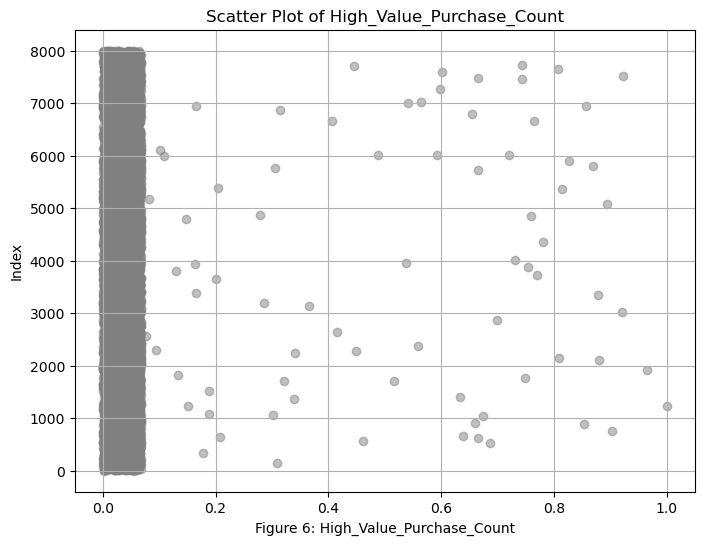

In [134]:
plt.figure(figsize=(8, 6))
plt.scatter(business_dataset['minmax'], range(len(business_dataset)), alpha=0.5, color='grey') 
plt.title('Scatter Plot of High_Value_Purchase_Count')
plt.xlabel('Figure 6: High_Value_Purchase_Count') 
plt.ylabel('Index')
plt.grid(True)
plt.show()

In [61]:
business_dataset['Product_Category_Preference'].unique()

array(['Basic', 'Gold', 'Platinum'], dtype=object)

In [62]:
total_sales_by_product_category = business_dataset.groupby('Product_Category_Preference')['Transaction_Amount'].sum()

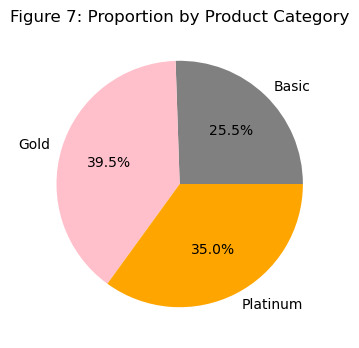

In [63]:
colors1 = ['grey', 'pink', 'orange',]

plt.figure(figsize=(4, 4))
plt.pie(total_sales_by_product_category, labels=total_sales_by_product_category.index, autopct='%1.1f%%', colors=colors1)
plt.title('Figure 7: Proportion by Product Category')
plt.show()

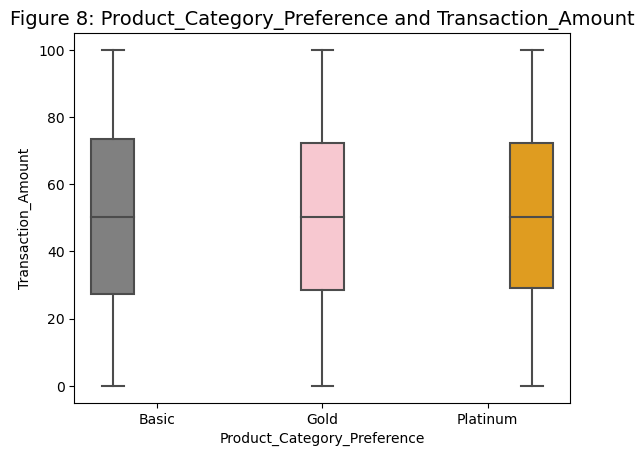

In [135]:
palette = ['grey', 'pink', 'orange',]

sns.boxplot(x = 'Product_Category_Preference', y = 'Transaction_Amount', data = business_dataset, hue = 'Product_Category_Preference', palette=palette)
plt.title('Figure 8: Product_Category_Preference and Transaction_Amount', fontsize = 14)
plt.legend([], [],frameon = False)
plt.show()

[Text(0.5, 0, 'Transaction_Amount'),
 Text(0, 0.5, 'Product_Category_Preference'),
 Text(0.5, 1.0, 'Figure 9: Transaction_Amount Histogram')]

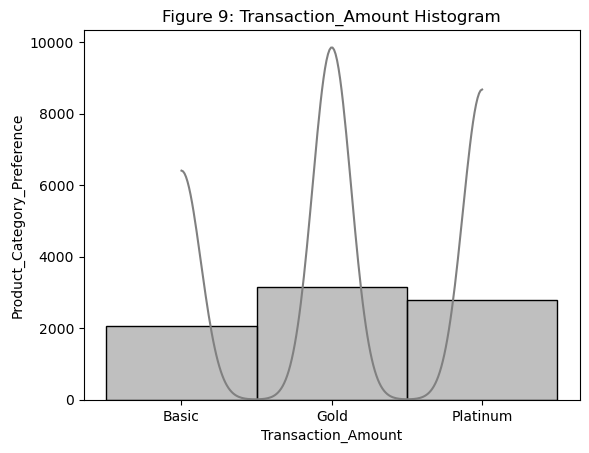

In [136]:
ax = sns.histplot(business_dataset.Product_Category_Preference, kde = True, color = 'grey')
ax.set(xlabel = 'Transaction_Amount', ylabel = 'Product_Category_Preference', title = 'Figure 9: Transaction_Amount Histogram')

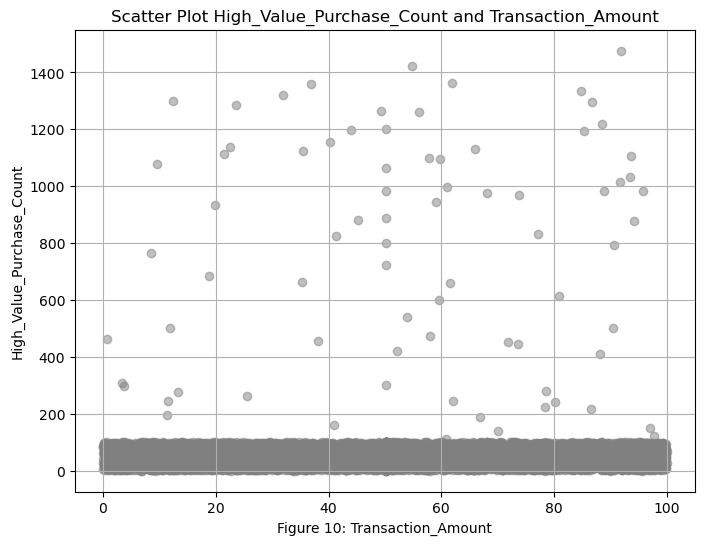

In [152]:
plt.figure(figsize=(8, 6))
plt.scatter(business_dataset['Transaction_Amount'], business_dataset['High_Value_Purchase_Count'], alpha=0.5, c='grey')
plt.title('Scatter Plot High_Value_Purchase_Count and Transaction_Amount')
plt.xlabel('Figure 10: Transaction_Amount')
plt.ylabel('High_Value_Purchase_Count')
plt.grid(True)
plt.show()

[Text(0.5, 0, 'Amount'),
 Text(0, 0.5, 'Transactions'),
 Text(0.5, 1.0, ' Figure 11: Sales Histogram')]

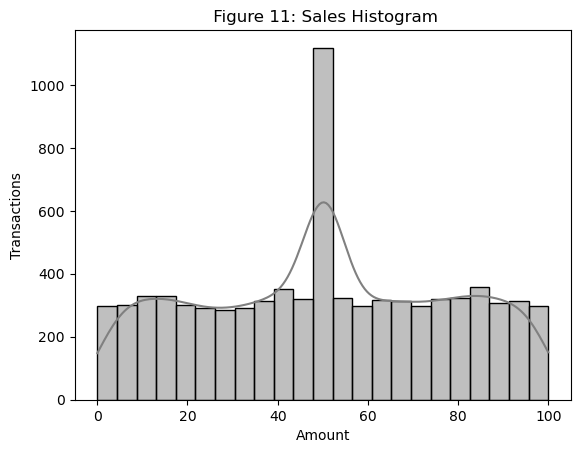

In [138]:
ax = sns.histplot(business_dataset['Transaction_Amount'], kde=True, color ='grey')
ax.set(xlabel='Amount', ylabel='Transactions', title =' Figure 11: Sales Histogram')

Text(0.5, 0, 'Figure 12: Transaction_Amount')

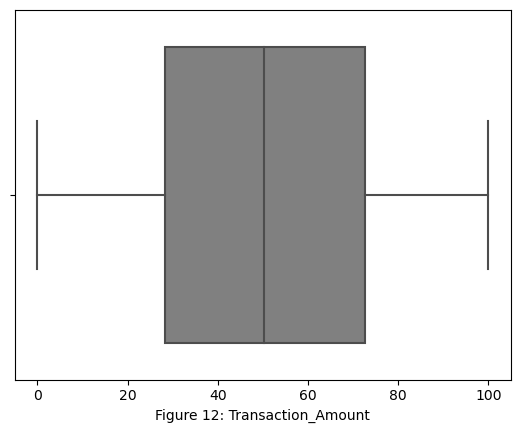

In [139]:
color3 = 'grey'

sns.boxplot(data=business_dataset, x='Transaction_Amount', palette=[color3])
plt.xlabel('Figure 12: Transaction_Amount')

## Campaign Response Rate:


#### Now, we gonna look at on representing by Marketing Email Click Rate(Numerical), Social Media Engagement Score(continuous numerical), Product Upsell Success(binary numerical), Interest in New Product (Binary categorical).

In [69]:
bd_features=business_dataset[['Marketing_Email_Click_Rate', 'Social_Media_Engagement_Score', 'Product_Upsell_Success', 'Interest_in_New_Product']]
bd_features.describe()

,Marketing_Email_Click_Rate,Social_Media_Engagement_Score,Product_Upsell_Success
count,8000.000000,8000.000000,8000.000000
mean,49.413815,50.521145,0.497125
std,28.729436,28.759969,0.500023
min,0.010000,0.000000,0.000000
25%,24.425000,25.430000,0.000000
50%,49.345000,50.705000,0.000000
75%,73.675000,75.480000,1.000000
max,99.970000,100.000000,1.000000


In [70]:
value_counts3 = business_dataset['Marketing_Email_Click_Rate'].value_counts()
value_counts3

Marketing_Email_Click_Rate
28.48    6
13.19    6
85.91    5
14.82    5
54.81    5
        ..
6.86     1
85.66    1
81.37    1
60.47    1
4.56     1
Name: count, Length: 5552, dtype: int64

In [71]:
relative_frequencies3 = value_counts3/len(business_dataset)
relative_frequencies3

Marketing_Email_Click_Rate
28.48    0.000750
13.19    0.000750
85.91    0.000625
14.82    0.000625
54.81    0.000625
           ...   
6.86     0.000125
85.66    0.000125
81.37    0.000125
60.47    0.000125
4.56     0.000125
Name: count, Length: 5552, dtype: float64

In [72]:
subtable3 = pd.DataFrame({'Marketing_Email_Click_Rate': value_counts3.index,
                        'Frequency': value_counts3.values,
                        'Relative Frequency': relative_frequencies3.values})

In [73]:
subtable3

,Marketing_Email_Click_Rate,Frequency,Relative Frequency
0,28.48,6,0.000750
1,13.19,6,0.000750
2,85.91,5,0.000625
3,14.82,5,0.000625
4,54.81,5,0.000625
...,...,...,...
5547,6.86,1,0.000125
5548,85.66,1,0.000125
5549,81.37,1,0.000125
5550,60.47,1,0.000125


### Social Media Engagement Score

In [74]:
value_counts4 = business_dataset['Social_Media_Engagement_Score'].value_counts()
value_counts4

Social_Media_Engagement_Score
69.13    6
7.01     5
62.13    5
11.01    5
7.37     5
        ..
22.56    1
51.61    1
23.10    1
62.49    1
12.81    1
Name: count, Length: 5507, dtype: int64

In [75]:
relative_frequencies4 = value_counts4/len(business_dataset)
relative_frequencies4

Social_Media_Engagement_Score
69.13    0.000750
7.01     0.000625
62.13    0.000625
11.01    0.000625
7.37     0.000625
           ...   
22.56    0.000125
51.61    0.000125
23.10    0.000125
62.49    0.000125
12.81    0.000125
Name: count, Length: 5507, dtype: float64

In [76]:
subtable4 = pd.DataFrame({'Social_Media_Engagement_Score': value_counts4.index,
                        'Frequency': value_counts4.values,
                        'Relative Frequency': relative_frequencies4.values})

In [77]:
subtable4

,Social_Media_Engagement_Score,Frequency,Relative Frequency
0,69.13,6,0.000750
1,7.01,5,0.000625
2,62.13,5,0.000625
3,11.01,5,0.000625
4,7.37,5,0.000625
...,...,...,...
5502,22.56,1,0.000125
5503,51.61,1,0.000125
5504,23.10,1,0.000125
5505,62.49,1,0.000125


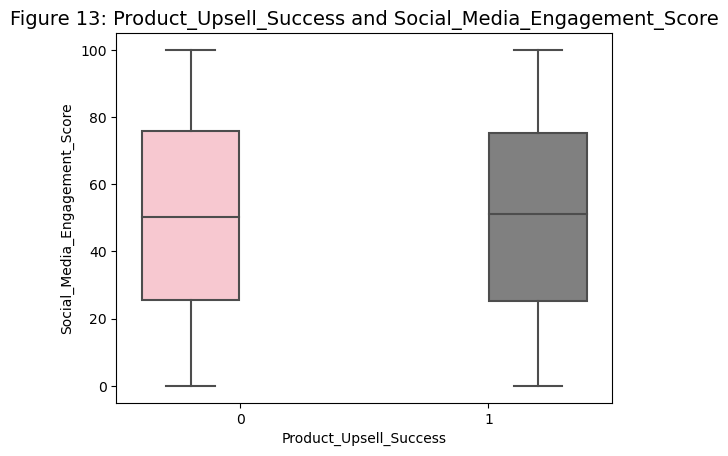

In [153]:
color3 = ['pink', 'grey']

sns.boxplot(x = 'Product_Upsell_Success', y = 'Social_Media_Engagement_Score', data = business_dataset, hue = 'Product_Upsell_Success', palette=color3)
plt.title('Figure 13: Product_Upsell_Success and Social_Media_Engagement_Score', fontsize = 14)
plt.legend([], [],frameon = False)
plt.show()

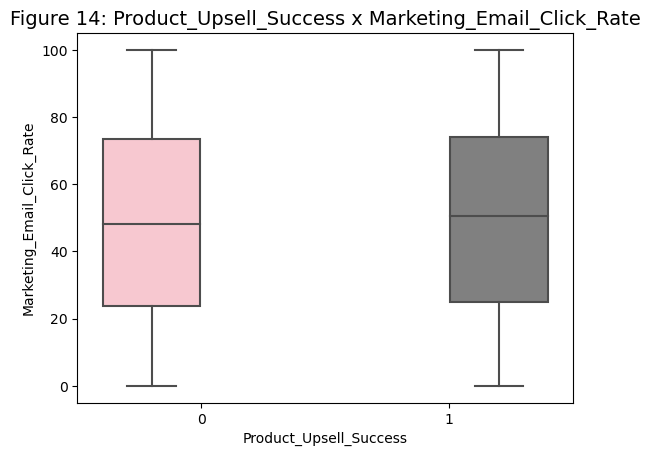

In [141]:
color3 = ['pink', 'grey']

sns.boxplot(x = 'Product_Upsell_Success', y = 'Marketing_Email_Click_Rate', data = business_dataset, hue = 'Product_Upsell_Success', palette=color3)
plt.title('Figure 14: Product_Upsell_Success x Marketing_Email_Click_Rate', fontsize = 14)
plt.legend([], [],frameon = False)
plt.show()

### Product Upsell Success
#### Upselling é uma estratégia de vendas na qual o vendedor sugere ao cliente a compra de produtos ou serviços adicionais, geralmente de maior valor ou com maior margem de lucro, em conjunto com o produto ou serviço original que o cliente já está interessado em adquiri

In [80]:
value_counts5 = business_dataset['Product_Upsell_Success'].value_counts()
value_counts5

Product_Upsell_Success
0    4023
1    3977
Name: count, dtype: int64

In [81]:
relative_frequencies5 = value_counts5/len(business_dataset) 
relative_frequencies5

Product_Upsell_Success
0    0.502875
1    0.497125
Name: count, dtype: float64

In [82]:
subtable5 = pd.DataFrame({'Product_Upsell_Success': value_counts5.index,
                        'Frequency': value_counts5.values,
                        'Relative Frequency': relative_frequencies5.values})

In [83]:
subtable5

,Product_Upsell_Success,Frequency,Relative Frequency
0,0,4023,0.502875
1,1,3977,0.497125


Text(0.5, 1.0, 'Figure 15: Product_Upsell_Success')

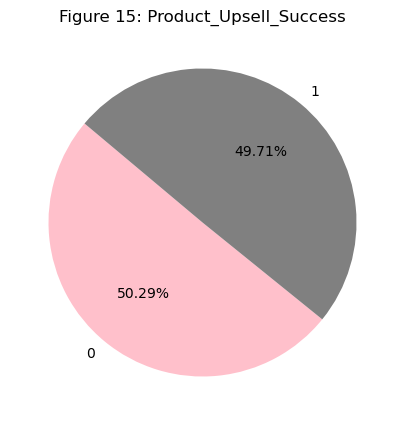

In [142]:
colors = ['pink', 'grey']

plt.figure(figsize = (5, 5))
plt.pie(value_counts5, labels = value_counts5.index, autopct = '%1.2f%%', startangle = 140, colors=colors)
plt.title('Figure 15: Product_Upsell_Success')

###  Interest in New Product

In [85]:
value_counts6 = business_dataset['Interest_in_New_Product'].value_counts()
value_counts6

Interest_in_New_Product
Yes    4049
No     3951
Name: count, dtype: int64

In [86]:
relative_frequencies6 = value_counts6/len(business_dataset) 
relative_frequencies6

Interest_in_New_Product
Yes    0.506125
No     0.493875
Name: count, dtype: float64

In [87]:
subtable6 = pd.DataFrame({'Interest_in_New_Product': value_counts6.index,
                        'Frequency': value_counts6.values,
                        'Relative Frequency': relative_frequencies6.values})

In [88]:
subtable6

,Interest_in_New_Product,Frequency,Relative Frequency
0,Yes,4049,0.506125
1,No,3951,0.493875


Text(0.5, 1.0, 'Figure 16: Percentage who has Interest in New Product')

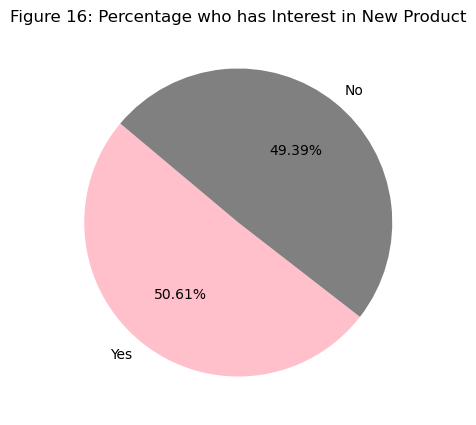

In [143]:
colors = ['pink', 'grey']

plt.figure(figsize = (5, 5))
plt.pie(value_counts6, labels = value_counts6.index, autopct = '%1.2f%%', startangle = 140, colors=colors)
plt.title('Figure 16: Percentage who has Interest in New Product')

## Customer Feedback Score:
Product Rating and Customer Satisfaction Score

As the Product Rating has missing values as described on the Data Dictionary, its beeing considerated the zero as those missing values. However the zero will be transformed through the mean of the variable, on this case 50.01.    Then after realised this point it has been transformed the scale of 1 to 100 in 1 to 5 considering 1, 2 , 3, 4 and 5.

In [90]:
columns = ['Product_Rating', 'Customer_Satisfaction_Score'] 
description_multiple_columns = business_dataset[columns].describe()

print(description_multiple_columns)

       Product_Rating  Customer_Satisfaction_Score
count     8000.000000                  8000.000000
mean        50.019625                    50.212000
std         27.319000                    28.984204
min          0.000000                     0.000000
25%         28.000000                    25.000000
50%         50.000000                    51.000000
75%         72.000000                    76.000000
max        100.000000                   100.000000


In [91]:
business_dataset['Product_Rating'].unique()

array([  6,  17,   9,  62,  41,  22,  50,  10,  94,  34,  52,  76,   3,
        70,   1,  91,  13,  21,  90,  28,  26,  32,  54,  93,  45,   4,
        67,  82,  83,  69,  60,  77,  40,  16,  68,  20,  71,  72,  84,
        12,  58,  61,  39,   7,  35,  55,  98,  64,  96,  66,  87,  56,
        80,  57,  46,  86,  14,   5,  44,  88,  85,  89,  47,  73,  23,
        42,  29,  18,  37,  74,  43,  99,  27,  97,  33,  81,  51,  36,
       100,  48,  95,  30,  31,  25,  79,  19,   8,  15,  24,  78,  53,
        11,  49,  63,   2,  38,   0,  59,  65,  75,  92], dtype=int64)

In [92]:
business_dataset_counts = business_dataset['Product_Rating'].value_counts()
business_dataset_counts

Product_Rating
50     877
7       92
22      90
23      89
89      88
      ... 
68      54
96      52
24      48
100     38
0       33
Name: count, Length: 101, dtype: int64

#### Define the mean for then replace the zeros one below:

In [93]:
business_dataset_median_product = business_dataset['Product_Rating'].median()

In [94]:
business_dataset['Product_Rating'] = business_dataset['Product_Rating'].replace(0, business_dataset_median_product)

In [95]:
#tranforming 1-100 in 1 to 5 scale.
def transform_rating(rating):
    if rating <= 20:
        return 1
    elif rating <= 40:
        return 2
    elif rating <= 60:
        return 3
    elif rating <= 80:
        return 4
    else:
        return 5
business_dataset['Product_Rating'] = business_dataset['Product_Rating'].apply(transform_rating)

In [96]:
business_dataset['Product_Rating'].unique()

array([1, 4, 3, 2, 5], dtype=int64)

In [97]:
business_dataset_counts_product = business_dataset['Product_Rating'].value_counts()
business_dataset_counts_product

Product_Rating
3    2295
2    1438
4    1432
1    1424
5    1411
Name: count, dtype: int64

In [98]:
relative_frequencies_products = business_dataset_counts_product/len(business_dataset)  
relative_frequencies_products

Product_Rating
3    0.286875
2    0.179750
4    0.179000
1    0.178000
5    0.176375
Name: count, dtype: float64

In [99]:
subtable_products = pd.DataFrame({'Product_Rating': business_dataset_counts_product.index,
                        'Frequency': business_dataset_counts_product.values,
                        'Relative Frequency': relative_frequencies_products.values})

In [100]:
subtable_products

,Product_Rating,Frequency,Relative Frequency
0,3,2295,0.286875
1,2,1438,0.179750
2,4,1432,0.179000
3,1,1424,0.178000
4,5,1411,0.176375


In [101]:
business_dataset['Product_Rating'].isnull().values.any()

False

In [102]:
zero_exist = (business_dataset['Product_Rating'] == 0).any()
zero_exist

False

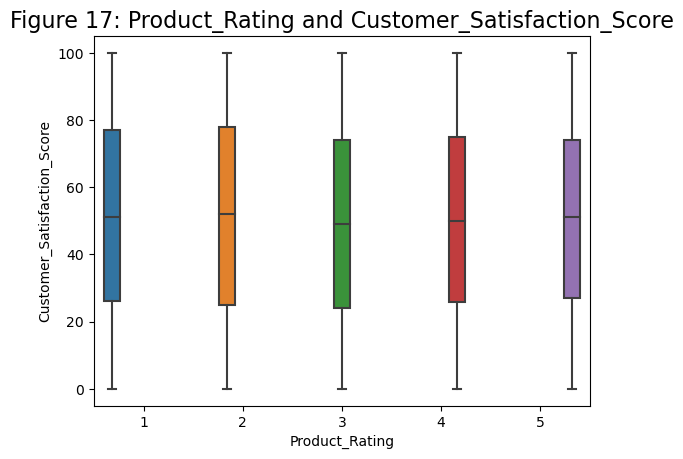

In [154]:
sns.boxplot(x = 'Product_Rating', y = 'Customer_Satisfaction_Score', data = business_dataset, hue = 'Product_Rating')
plt.title('Figure 17: Product_Rating and Customer_Satisfaction_Score', fontsize = 16)
plt.legend([], [],frameon = False)
plt.show()

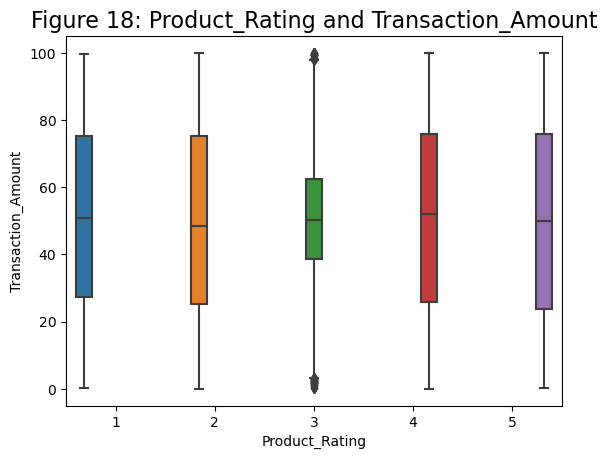

In [155]:
sns.boxplot(x = 'Product_Rating', y = 'Transaction_Amount', data = business_dataset, hue = 'Product_Rating')
plt.title('Figure 18: Product_Rating and Transaction_Amount', fontsize = 16)
plt.legend([], [],frameon = False)

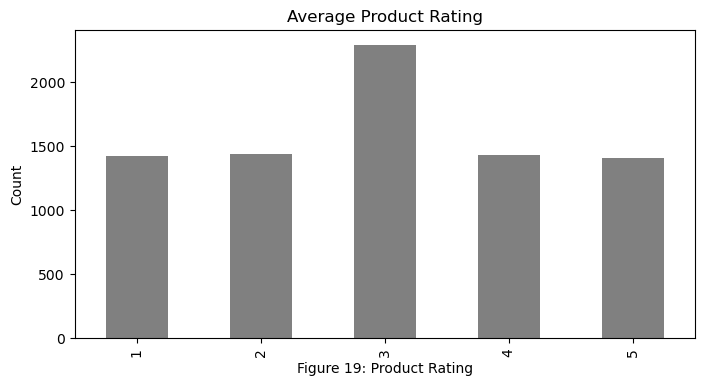

In [146]:
business_dataset['Product_Rating'].value_counts().sort_index().plot(kind="bar", figsize=(8,4), color='grey')

plt.title("Average Product Rating")
plt.ylabel("Count")
plt.xlabel("Figure 19: Product Rating")
plt.show()

[Text(0.5, 0, 'Product Rating'),
 Text(0, 0.5, 'Count'),
 Text(0.5, 1.0, 'Figure 20: Product_Rating')]

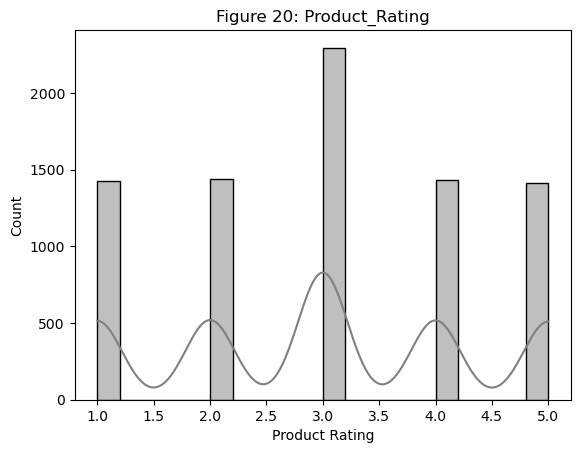

In [147]:
ax = sns.histplot(business_dataset.Product_Rating, kde = True, color='grey')
ax.set(xlabel = 'Product Rating', ylabel = 'Count', title = 'Figure 20: Product_Rating')

In [107]:
import plotly.express as px
Product_Rating_order = ['1', '2', '3', '4', '5']

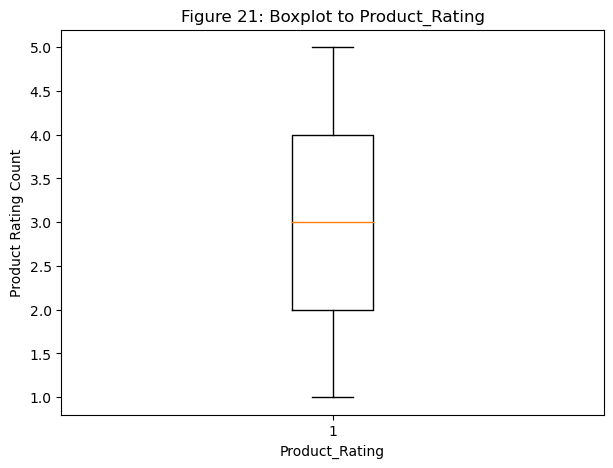

In [148]:
plt.figure(figsize=(7, 5))
plt.boxplot(business_dataset['Product_Rating'])
plt.title('Figure 21: Boxplot to Product_Rating')
plt.ylabel('Product Rating Count')
plt.xlabel('Product_Rating')
plt.show()

### Customer Satisfaction Score

In [109]:
business_dataset_counts = business_dataset['Customer_Satisfaction_Score'].value_counts()
business_dataset_counts

Customer_Satisfaction_Score
80     101
32     100
3       98
30      97
97      95
      ... 
40      61
66      61
22      61
0       44
100     35
Name: count, Length: 101, dtype: int64

In [110]:
business_dataset['Customer_Satisfaction_Score'].unique()

array([ 37,  79,  97,  73,   3,  43,  91,  17,  64,  24,  29,  50,   5,
        74,  32,  10,  55,  78,  99,  70,  47,  52,  95,   9,  98,  53,
        84,  12,  15,  71,  92,   7,  16,  21,   2,  60,  26,  19,  87,
         6,  54,  76,  80,  34,  67,  69,   4,  30,  96,  94,  46,  28,
        90,  27,  83,  35,  63,  39,  85,  66,  48,  13,  61,  89,  82,
        75,  62,  45,  14,  77,  93,   8,  42,  57,  58,  68, 100,  38,
        31,  20,  25,   0,   1,  40,  23,  41,  36,  72,  65,  51,  33,
        86,  81,  44,  49,  88,  18,  11,  59,  22,  56], dtype=int64)

In [111]:
business_dataset['Customer_Satisfaction_Score'].isnull().values.any()

False

Text(0.5, 0, 'Figure 22: Customer Satisfaction Score')

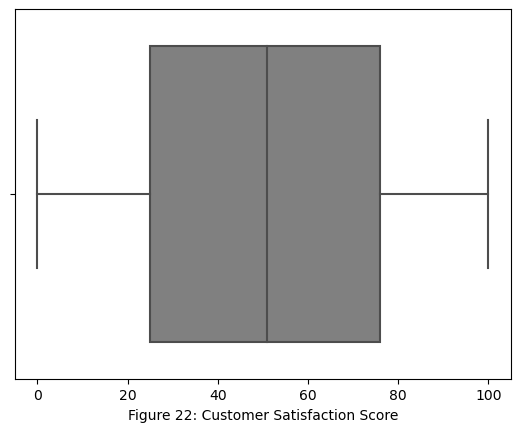

In [149]:
color3 = 'grey'
sns.boxplot(data=business_dataset, x='Customer_Satisfaction_Score', palette=[color3])
plt.xlabel('Figure 22: Customer Satisfaction Score')

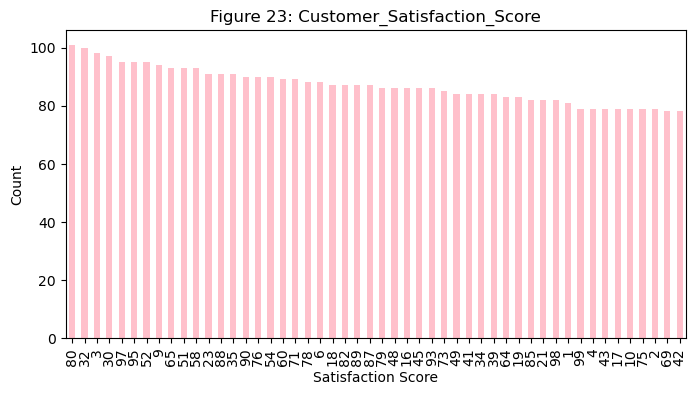

In [216]:
business_dataset.Customer_Satisfaction_Score.value_counts().nlargest(50).plot(kind="bar", figsize=(8,4), color='pink')
plt.title("Figure 23: Customer_Satisfaction_Score")
plt.ylabel("Count")
plt.xlabel("Satisfaction Score");

## Task 3 and 4:

#### The process of choosen was select just the categorical, because the continuous would be hard to understand a pattern of probability of customers who responded the new marketing initiatives based on historical data.

### Choosen through of the task 1:
Product_Category_Preference, Customer_Segment_Group, Interest_in_New_Product, Product_Rating


## Customer_Segment_Group x Product_Category_Preference

It will be considerated for the questions below:

k= % of the sample, n=sample size and p=probability

In [115]:
import statistics as stats
from scipy.stats import binom

In [116]:
cross_tab = pd.crosstab(index=business_dataset['Product_Category_Preference'], columns=business_dataset['Customer_Segment_Group'])

print(cross_tab)

Customer_Segment_Group         A    B    C    D
Product_Category_Preference                    
Basic                        500  543  515  497
Gold                         839  765  774  784
Platinum                     659  720  689  715


#### Segment 'B' interesting in Gold products:

In [117]:
(765 / 1998)

0.38288288288288286

In [171]:
binom.cdf(k =40 , n = 102  , p = 0.3828) 

0.6191795029338351

In [172]:
binom.cdf(k =50 , n = 102  , p = 0.3828) 

0.9894822737181891

## Customer_Segment_Group x Subscription_Status

In [119]:
cross_tab = pd.crosstab(index=business_dataset['Subscription_Status'], columns=business_dataset['Customer_Segment_Group'])

print(cross_tab)

Customer_Segment_Group     A     B     C     D
Subscription_Status                           
0                       1008  1079  1005   922
1                        990   949   973  1074


#### Who are subscribed by segment A:

In [120]:
(1008 / 1998)

0.5045045045045045

#### Calculate probability between 50 and 60 inclusive, it was substract from P(x=<60) - P(x=<50):

In [177]:
binom.cdf(k =60 , n = 100 , p = 0.5045) - binom.cdf(k =49 , n = 100 , p = 0.5045)

0.5535104187863269

#### Calculate probability between 50 and 70 inclusive, it was substract from P(x=<70) - P(x=<50):

In [184]:
binom.cdf(k =70 , n = 100 , p = 0.5045) - binom.cdf(k =49 , n = 100 , p = 0.5045)

0.5753779630814447

## Customer_Segment_Group x Interest_in_New_Product

In [122]:
cross_tab = pd.crosstab(index=business_dataset['Interest_in_New_Product'], columns=business_dataset['Customer_Segment_Group'])

print(cross_tab)

Customer_Segment_Group      A     B     C     D
Interest_in_New_Product                        
No                        959   980  1017   995
Yes                      1039  1048   961  1001


#### Who has interesting on the product by the segment B:

In [123]:
(1048 / 1998)

0.5245245245245245

#### Calculate probability between 50 and 60 inclusive, it was substract from P(x=<60) - P(x=<49):

In [124]:
binom.cdf(k =60 , n = 102 , p = 0.52002) - binom.cdf(k =49 , n = 102 , p = 0.5245)

0.7168895219792664

#### Calculate probability between 50 and 80 inclusive, it was substract from P(x=<80) - P(x=<49):

In [186]:
binom.cdf(k =80 , n = 102 , p = 0.52002) - binom.cdf(k =49 , n = 102 , p = 0.5245)

0.786178606929099

## Task 5:
#### Customer_Satisfaction_Score

Optou-se por associar Customer_Satisfaction_Score com o High_Value_Purchase_Count, neste caso o minmaxScaler pois ouve uma reducao de dimensionalidade em decorrencia de outliers.

In [215]:
bd_features=business_dataset[['minmax', 'Customer_Satisfaction_Score']]
bd_features.describe()

,minmax,Customer_Satisfaction_Score
count,8000.000000,8000.000000
mean,0.038691,50.212000
std,0.058212,28.984204
min,0.000000,0.000000
25%,0.017316,25.000000
50%,0.034384,51.000000
75%,0.051239,76.000000
max,1.000000,100.000000


In [126]:
from scipy.stats import norm

In [ ]:
µ = mu
σ = sigma

In [127]:
mu = 50.212000            
sigma = 28.984204         

#### Calculate the satisfaction score lower than 40 points --> P(x < 40):

In [209]:
norm.cdf(40, mu, sigma)

0.36229545545376285

#### We calculate the satisfaction score  greater than 40 points --> P(X > 40):

In [208]:
norm.sf(40, mu, sigma)

0.6377045445462372

#### Calculate between 50 and 80 points --> P(x<50) - P(x<80):

In [206]:
norm.cdf(80, mu, sigma) - norm.cdf(50, mu, sigma)

0.35088006275948574

In [131]:
import matplotlib.pyplot as plt

In [132]:
x = np.linspace(0, 100, 500)       

pdf_values = norm.pdf(x, mu, sigma)

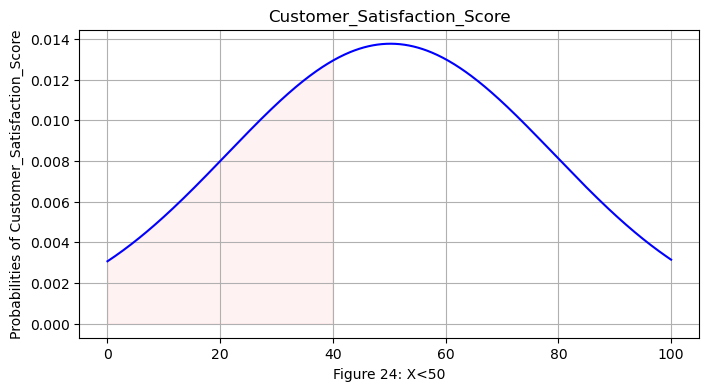

In [210]:
plt.figure(figsize=(8,4))
plt.plot(x, pdf_values, label = 'Customer_Satisfaction_Score', color = 'blue')


plt.fill_between(x, pdf_values, where = (x<40), color = 'red', alpha = 0.05, label = 'X <40')

plt.title('Customer_Satisfaction_Score')
plt.xlabel('Figure 24: X<50')
plt.ylabel('Probabilities of Customer_Satisfaction_Score')
plt.grid(True)
plt.show()